In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pickle

from matplotlib import font_manager
import matplotlib as mpl
font_dirs = ['/home/gridsan/ezw/fonts/helvetica/']
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)

for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams['font.family'] = 'Helvetica'

In [2]:
from torch import matmul
from torch import tensor

def get_binding_energies(bcell_residues, bcell_epitope, viruses):
    """
    Output is of dimension Bcells, viruses
    """
    # group by epitope id so that a single virus residue matrix can be used
    bcell_ids = []
    bindings_ = []
    for epitope_id in np.sort(np.unique(bcell_epitope)):
        bcell_id = np.where(bcell_epitope == epitope_id)[0]
        bcell_ids.append(bcell_id)
        viruses_ = tensor(viruses[:, :, epitope_id])
        bcell_residues_ = tensor(bcell_residues[bcell_id, :].T)
        bindings = matmul(viruses_, bcell_residues_).numpy().T
        bindings_.append(bindings)

    if len(bcell_ids) == 0:
        return np.array([])

    bcell_ids = np.concatenate(bcell_ids)

    # need to reorder bcell_ids
    reordered = np.empty_like(bcell_ids)
    tmp = np.arange(bcell_ids.size)
    for i, idx in enumerate(bcell_ids):
        reordered[idx] = tmp[i]
    bcell_ids = reordered

    binding_energies = np.concatenate(bindings_)[bcell_ids, :]
    return binding_energies

In [3]:
data=pickle.load(open('pkl/history0_0.pkl', 'rb'))
print(data.keys())
print(data['viruses'].keys())
print(data['plasma_bcells'].keys())

dict_keys(['viruses', 'gc_bcells', 'plasma_bcells', 'memory_bcells', 'panel_viruses', 'panel_bnabs'])
dict_keys(['nclones', 'epitope_id', 'strains', 'recomb', 'init_distance', 'binding', 'cons_distance', 'cons_value', 'breadth', 'binding_panel', 'prerecomb_E', 'postrecomb_E', 'recomb_times', 'residues'])
dict_keys(['nclones', 'epitope_id', 'strains', 'recomb', 'init_distance', 'binding', 'cons_distance', 'cons_value', 'breadth', 'binding_panel', 'prerecomb_E', 'postrecomb_E', 'recomb_times', 'residues'])


Text(0.5, 0, 'mpi')

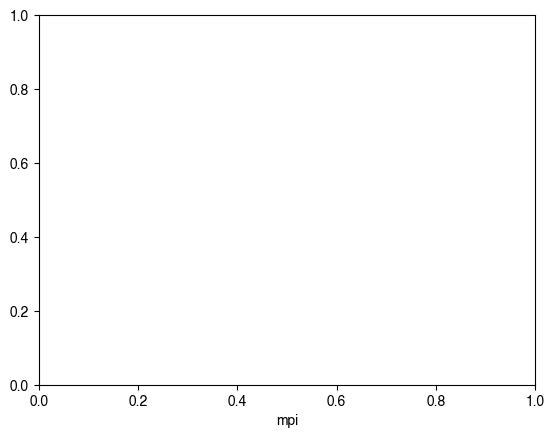

In [4]:
data=pickle.load(open('pkl/history0_20.pkl', 'rb'))
time = np.arange(len(data['viruses']['nclones'])) * 10 / 30

from populations import *

def get_energies(data):
    energies = []
    x = data['plasma_bcells']
    for i, (residue, epitope_id, nclone) in enumerate(zip(x['residues'], x['epitope_id'], x['nclones'])):
        bindE = get_binding_energies(residue, epitope_id, data['panel_viruses'])
        energies.append(bindE)
    return energies


def paneltiters(data, threshold):
    titers_ = []
    x = data['plasma_bcells']
    for i, (residue, epitope_id, nclone) in enumerate(zip(x['residues'], x['epitope_id'], x['nclones'])):
        bindE = get_binding_energies(residue, epitope_id, data['panel_viruses'])
        bindE[bindE > threshold] = 1
        bindE[bindE != 1] = 0
        titer = np.array([nclone[np.where(col > 0)].sum() for col in bindE.T])
        titers_.append(titer)
    return np.array(titers_)


def binding_titer(data, threshold, pop='plasma_bcells', binding_type='binding'):
    titers_ = []
    for i, timepoint in enumerate(data[pop][binding_type]):
        nclones = data[pop]['nclones'][i]
        inds = np.where(timepoint > threshold)
        titer = (nclones[inds]).sum()
        titers_.append(titer)
    return titers_

def binding_bnabs(data):
    bindings_ = []
    for i, timepoint in enumerate(data['viruses']['binding_panel']):
        nclones = data['viruses']['nclones'][i]
        avgbinding = (timepoint * nclones).sum() / nclones.sum()
        bindings_.append(avgbinding)
    return bindings_

def binding_gc(data, threshold):
    titers_ = []
    pop = 'gc_bcells'
    for i, timepoint in enumerate(data[pop]['binding']):
        titer = 0
        for j, gc in enumerate(timepoint):
            nclones = data[pop]['nclones'][i][j]
            inds = np.where(gc > threshold)
            titer += (gc[inds] * nclones[inds]).sum() / (nclones[inds].sum()+0.001)
        titers_.append(titer)
    return titers_

def breadth(data, threshold_i, pop='plasma_bcells'):
    breadths = []
    for i, timepoint in enumerate(data[pop]['breadth']):
        breadth = timepoint[threshold_i]
        nclones = data[pop]['nclones'][i]
        avg_breadth = (breadth * nclones).sum() / nclones.sum()
        breadths.append(avg_breadth)
    return breadths

def filtered_epid(data, attr, time, gc):
    eps = data['gc_bcells']['epitope_id'][time][gc]
    return data['gc_bcells'][attr][time][gc][np.where(eps==0)]


#plt.plot(time, [x.sum() for x in data['viruses']['nclones']])
#plt.plot(time, [x.size for x in data['viruses']['nclones']])
#plt.plot(time, [x.mean() for x in data['viruses']['nclones']])
#plt.plot(time, [x.mean() for x in data['viruses']['recomb']])
#plt.plot(time, [x.mean() for x in data['viruses']['cons_distance']])
#plt.plot(time, [x.mean() for x in data['viruses']['cons_value']])
#plt.plot(time, [x.mean() for x in data['viruses']['binding']])
#plt.plot(time, [np.where(x==0)[0].size/(x.size+0.001) for x in data['viruses']['strains']])

#plt.plot(time, [x.mean() for x in data['plasma_bcells']['cons_distance']])
#plt.plot(time, [x.mean() for x in data['plasma_bcells']['cons_value']])
#plt.plot(time, [x.sum() for x in data['plasma_bcells']['nclones']])

#plt.plot(time, [x[x==0].size/(x.size+0.0001) for x in data['memory_bcells']['epitope_id']])
#y = [x[x==0].size/(x.size+0.0001) for x in data['plasma_bcells']['epitope_id']]
#plt.plot(time, np.cumsum(y) / np.arange(len(y)))
#plt.plot(time, [x.mean() for x in data['plasma_bcells']['binding']])
#plt.plot(time, [np.concatenate([x for x in y]).mean() for y in data['gc_bcells']['binding']])
#plt.plot(time, breadth(data, 5))
#plt.plot(time, titers(data, 3))
#plt.plot(time, titers_gc(5))


# z=[np.concatenate(x) for x in data['gc_bcells']['epitope_id']]
# nclones = [np.concatenate(x) for x in data['gc_bcells']['nclones']]
# zeroinds = [np.where(x==0)[0] for x in z]
# zerosum = [nclone[zeroind].sum() for nclone, zeroind in zip(nclones, zeroinds)]
# totsum = [nclone.sum() for nclone in nclones]
# z1 = [zsum/(tsum+0.0001) for zsum, tsum in zip(zerosum, totsum)]
# plt.plot(time, z1)
# plt.plot(time, np.cumsum(z1) / np.arange(len(z1)))

# y = [np.concatenate([filtered_epid(data, 'cons_value', t, gc) 
#                      for gc in range(20)]).mean() 
#      for t in np.arange(len(data['gc_bcells']['epitope_id']))]
# plt.plot(time, y)

plt.xlabel('mpi')
#plt.yscale('log')

In [5]:
import gc

def calc_percent_bnab(data):
    """
    Percent of GC cells that are bnAb precursor for a single random seed
    """
    z=[np.concatenate(x) for x in data['gc_bcells']['epitope_id']]
    nclones = [np.concatenate(x) for x in data['gc_bcells']['nclones']]
    zeroinds = [np.where(x==0)[0] for x in z]
    zerosum = [nclone[zeroind].sum() for nclone, zeroind in zip(nclones, zeroinds)]
    totsum = [nclone.sum() for nclone in nclones]
    z1 = [zsum/tsum for zsum, tsum in zip(zerosum, totsum)]
    return z1

def binding_bnab_manyseeds(file):
    """
    Avg binding energy to bnab panel
    """
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        bindings = [np.nanmean(x) for x in binding_bnabs(data)]
        bindings = np.nan_to_num(bindings)
        lst.append(bindings)
    return lst, time


def meanpaneltiter_manyseeds(file, threshold):
    """
    Mean panel titer for many different random seeds.
    """
    cnt = 0
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        titers_ = [np.nanmean(x) for x in paneltiters(data, threshold)]
        titers_ = np.nan_to_num(titers_)
        lst.append(titers_)
    return lst, time


def bindingtiter_manyseeds(file, threshold, binding_type='binding_panel'):
    """
    Binding for many different random seeds. Specify whether to circulating viruses
    or to virus panel
    """
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        bindings_ = binding_titer(data, threshold, binding_type=binding_type)
        lst.append(bindings_)
    return lst, time
        
        
def plasma_manyseeds(file):
    """
    Number of plasma cells for many different random seeds
    """
    cnt = 0
    tot = 30
    clone_lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        nclones = [x.sum() for x in data['plasma_bcells']['nclones']]
        if nclones[-1] > 4000:
            cnt += 1
        clone_lst.append(nclones)
    print('plasma', cnt / tot)
    return clone_lst, time

def nvirus_manyseeds(file):
    """
    Number of viruses for many different random seeds
    """
    cnt = 0
    tot = 30
    clone_lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        nclones = [x.sum() for x in data['viruses']['nclones']]
        clone_lst.append(nclones)
    return clone_lst, time


def gc_manyseeds(file):
    """
    Number of GC cells for many different random seeds
    """
    cnt = 0
    tot = 30
    clone_lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        nclones = [np.concatenate([x for x in y]).sum() for y in data['gc_bcells']['nclones']]
        clone_lst.append(nclones)
    print('plasma', cnt / tot)
    return clone_lst, time
    
    
def percent_manyseeds(file):
    """
    Percent of GC cells that are bnAb precursor
    """
    cnt = 0
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        percents = calc_percent_bnab(data)
        lst.append(percents)
    return lst, time


def breadth_manyseeds(file, threshold_i):
    cnt = 0
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        breadth_ = breadth(data, threshold_i)
        lst.append(breadth_)
    return lst, time
    

def consvalue_manyseeds(file):
    """
    Avg value of conserved residue in virus
    """
    cnt = 0
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['viruses']['nclones'])) * 10 / 30
        lst.append([x.mean() for x in data['viruses']['cons_value']])
    return lst, time

def consvalue_plasma_manyseeds(file):
    """
    Avg value of conserved residue in plasma cells
    """
    cnt = 0
    tot = 30
    lst = []
    for seed in range(tot):
        gc.collect()
        data = pickle.load(open(f'{file}_{seed}.pkl', 'rb'))
        time = np.arange(len(data['plasma_bcells']['nclones'])) * 10 / 30
        #zeroinds = [np.where(x==0)[0] for x in data['plasma_bcells']['epitope_id']]
        #lst.append([x[ind].mean() for x, ind in zip(data['plasma_bcells']['cons_value'], zeroinds)])
        lst.append([x.mean() for x in data['plasma_bcells']['cons_value']])
    return lst, time

def makeplot(fn, num_timepoints, arg=None):
    ylabels = {consvalue_manyseeds: 'Avg virus cons. residue',
               consvalue_plasma_manyseeds: 'Avg plasma cons. residue', 
               percent_manyseeds: 'Fraction bnAb precursor',
               gc_manyseeds: 'Num GC B-cells',
               nvirus_manyseeds: 'Num viruses',
               meanpaneltiter_manyseeds: 'Mean panel titer',
               bindingtiter_manyseeds: 'Mean titer to virus pop.',
               binding_bnab_manyseeds: "Mean binding to bnab"}
    plt.figure(figsize=(4.2,3),dpi=600)

    colors = ['blue', 'red', 'green', 'orange', 'black', 'purple']
    distances = [0,2,4,8,12]
    distances = [0, 4, 12, 16,20,24]
    #distances = [0,10,20,30,40,50]
    means = []

    for c in colors:
        plt.plot([], [], c)

    for c, d in zip(colors, distances):
        file = f'pkl/history{d}'
        
        if arg:
            array, time = fn(file, arg)
        else:
            array, time = fn(file)
        num_timepoints = num_timepoints
        time = time[:num_timepoints]
        array = [x[:num_timepoints] for x in array]
        array = np.array(array)
        for v in array:
            plt.plot(time, v, color=c, linewidth=0.2)
        means.append(np.nanmean(array, axis=0))
    
    for mean, c, d in zip(means, colors, distances):
        plt.plot(time, mean, color=c, linewidth=3)

    plt.xlabel('Months post infection')
    plt.ylabel(ylabels[fn])
    plt.legend([f'd={d}' for d in distances])


    plt.tight_layout()

In [6]:
ntp = 200

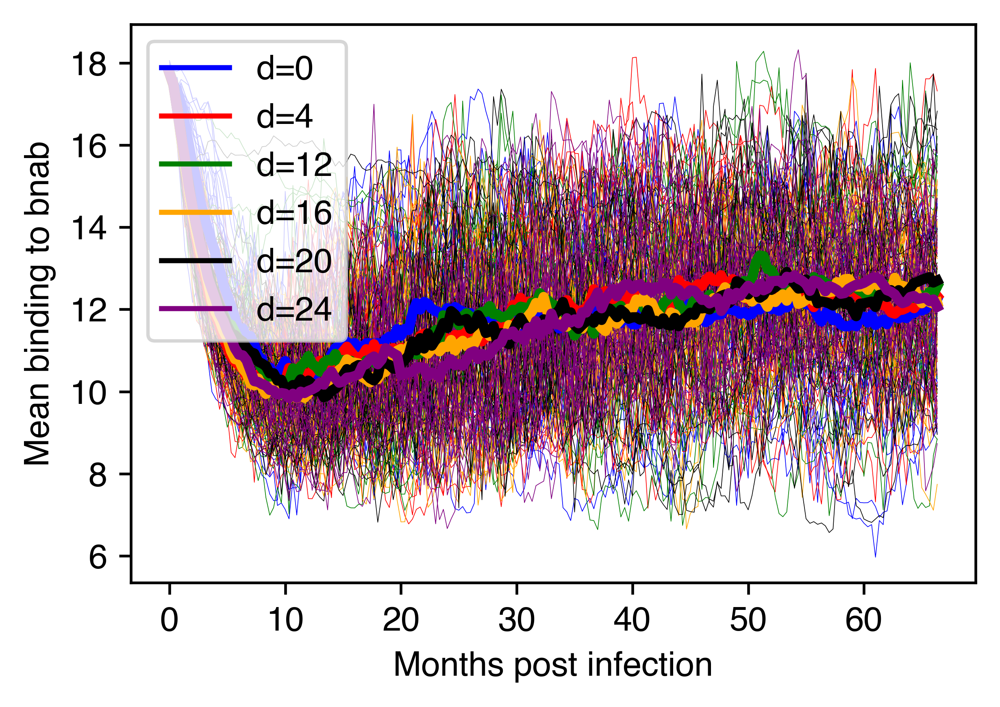

In [7]:
makeplot(binding_bnab_manyseeds, ntp)


/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/1396725631.py:12: RuntimeWarning: invalid value encountered in long_scalars
  z1 = [zsum/tsum for zsum, tsum in zip(zerosum, totsum)]
/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/1396725631.py:207: RuntimeWarning: Mean of empty slice
  means.append(np.nanmean(array, axis=0))


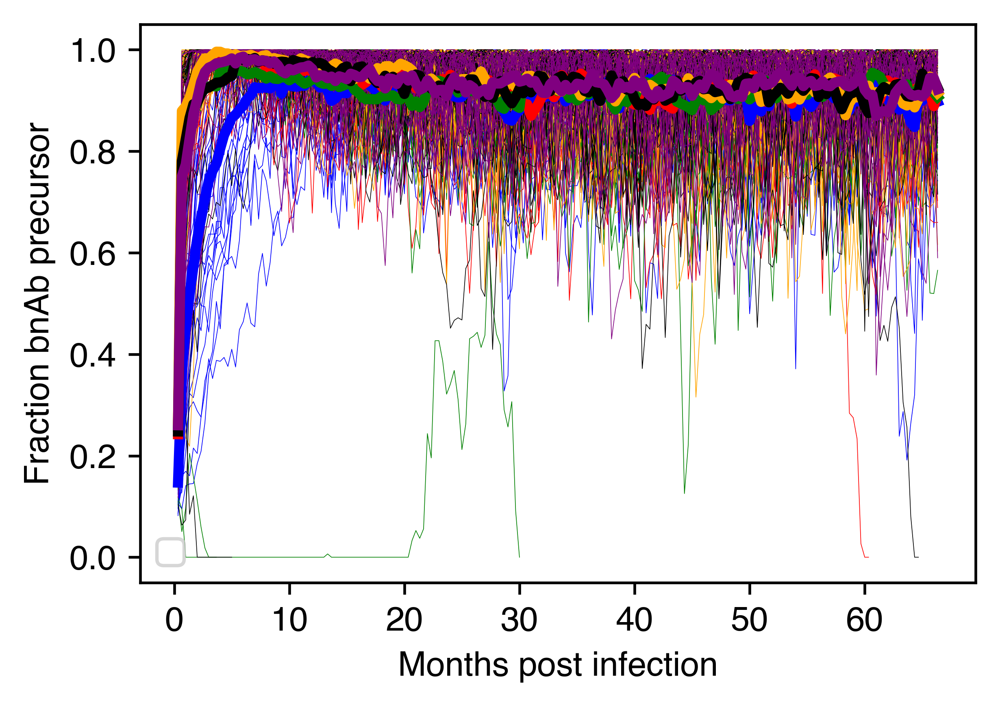

In [8]:
makeplot(percent_manyseeds, ntp)
plt.legend([])

/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/3092801030.py:24: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(titers_)
/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/1396725631.py:42: RuntimeWarning: Mean of empty slice
  titers_ = [np.nanmean(x) for x in paneltiters(data, threshold)]


(0.0, 3000.0)

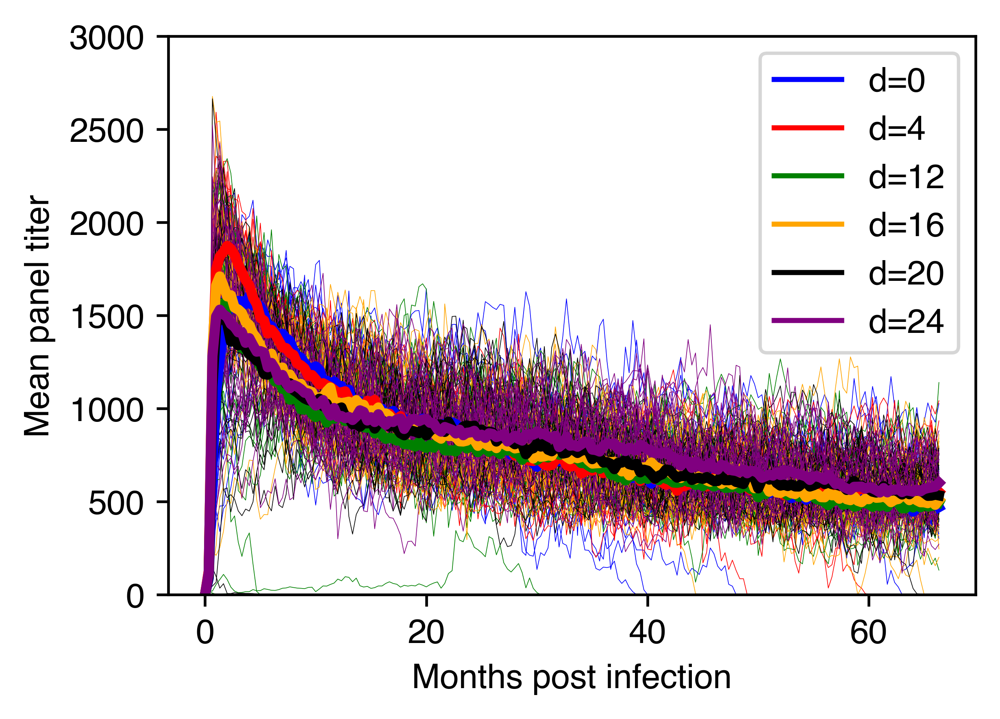

In [9]:
makeplot(meanpaneltiter_manyseeds, ntp, arg=2)
plt.ylim([0,3000])

plasma 0.0
plasma 0.0
plasma 0.0
plasma 0.0
plasma 0.0
plasma 0.0


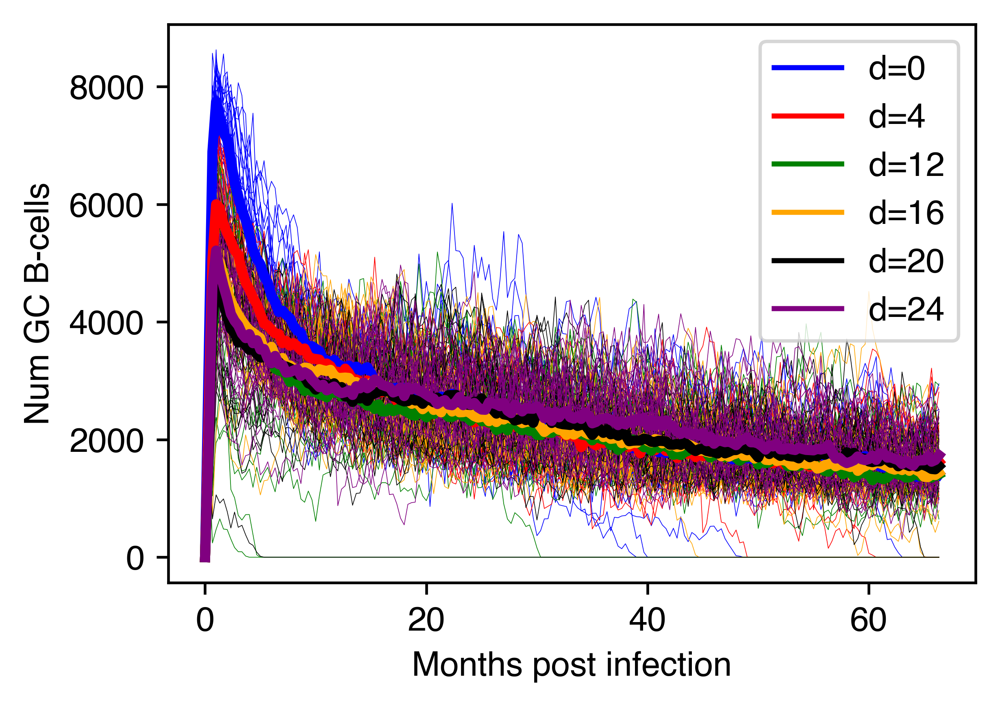

In [10]:
makeplot(gc_manyseeds, ntp)

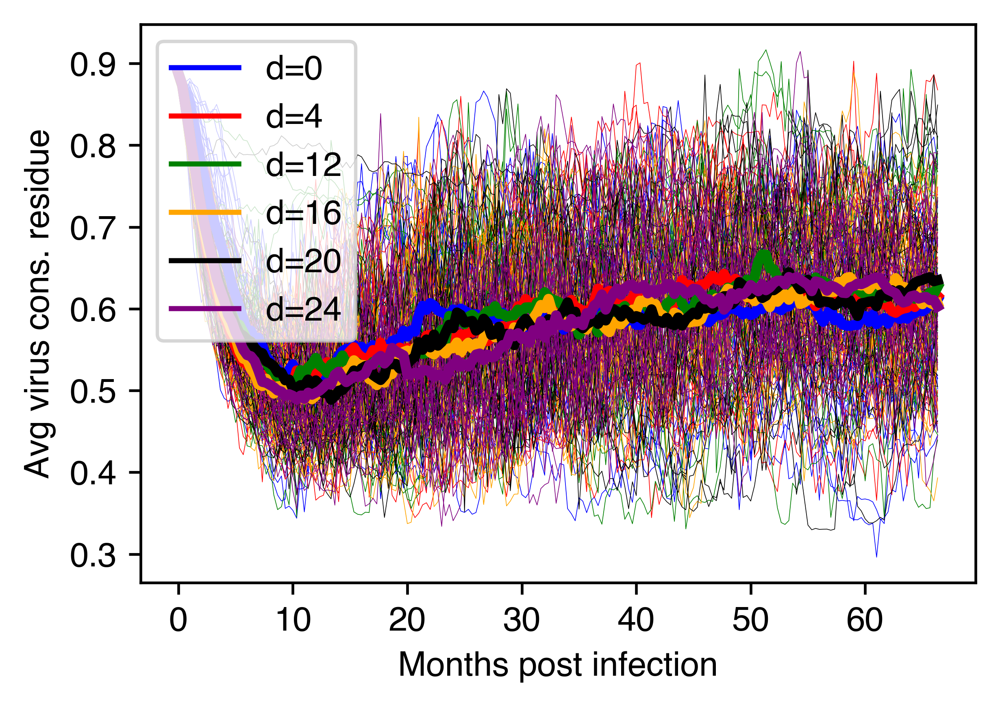

In [11]:
makeplot(consvalue_manyseeds, ntp)

/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/1396725631.py:171: RuntimeWarning: Mean of empty slice.
  lst.append([x.mean() for x in data['plasma_bcells']['cons_value']])
/state/partition1/llgrid/pkg/anaconda/anaconda3-2022b/lib/python3.8/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/state/partition1/slurm_tmp/24700013.0.0/ipykernel_2291162/1396725631.py:207: RuntimeWarning: Mean of empty slice
  means.append(np.nanmean(array, axis=0))


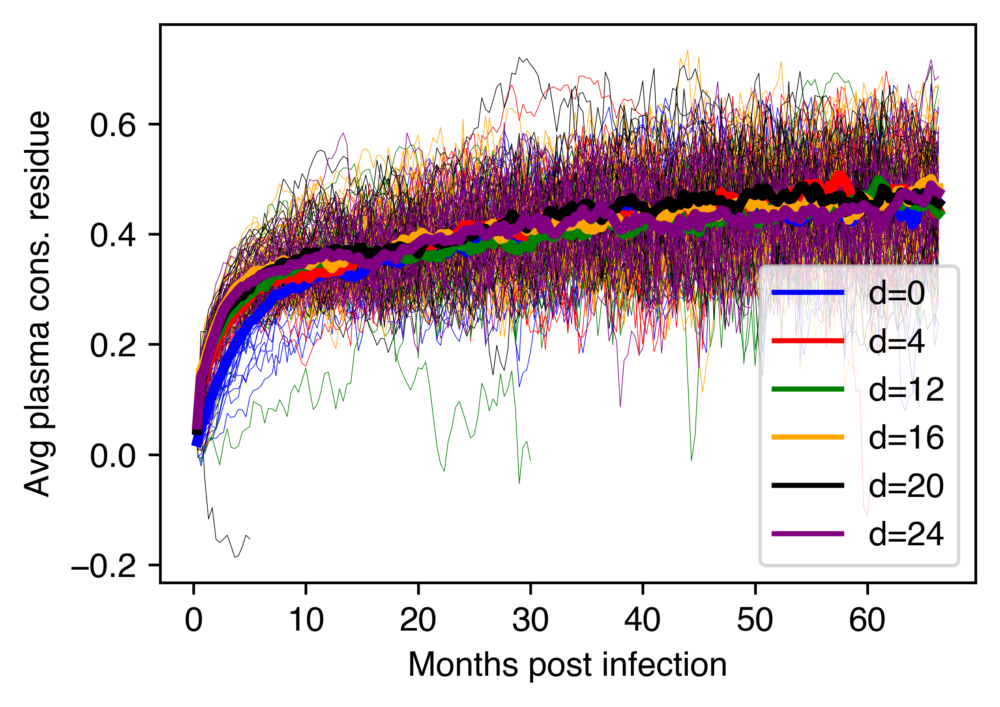

In [12]:
makeplot(consvalue_plasma_manyseeds, ntp)

(0.0, 3000.0)

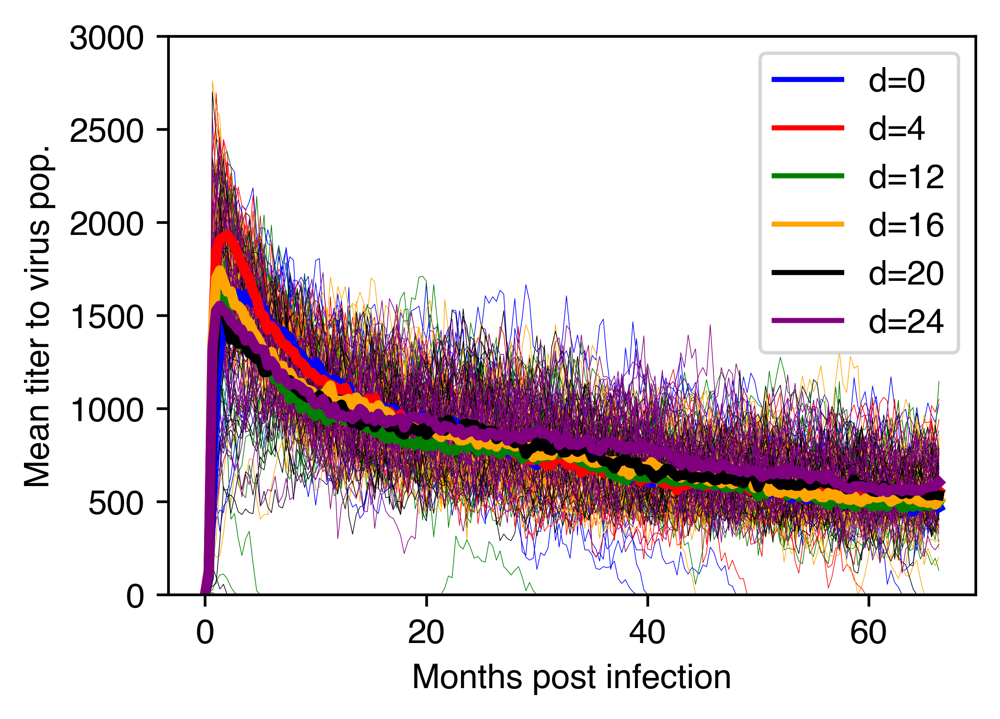

In [13]:
makeplot(bindingtiter_manyseeds, ntp, arg=2)
plt.ylim([0,3000])

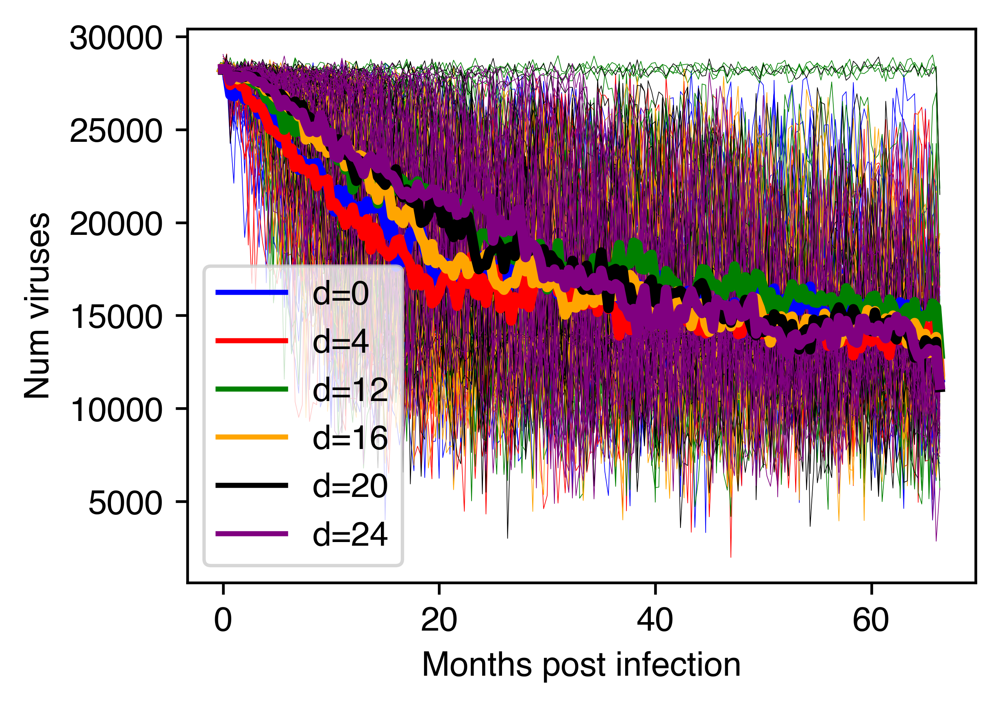

In [14]:
makeplot(nvirus_manyseeds, ntp)

In [25]:
# plt.figure(figsize=(4.5,3),dpi=600)

# colors = ['blue', 'red', 'green', 'orange', 'black', 'purple']
# distances = [0,2,4,8,12]
# #distances = [0,10,20,30,40,50]

# for c in colors:
#     plt.plot([], [], c)
    
# for c, d in zip(colors, distances):
#     file = f'pkl/history{d}'
    
#     array, time = meanpaneltiter_manyseeds(file,2)
#     #array, time = gc_manyseeds(file)
#     #array, time = consvalue_manyseeds(file)
#     #array, time = bindingtiter_manyseeds(file, 3, binding_type='binding')
#     num_timepoints = 50
#     time = time[:num_timepoints]
#     array = [x[:num_timepoints] for x in array]
    
    
#     #array, time = titers_manyseeds(file, 0.1)
#     #array, time = percent_manyseeds(file)
#     #array, time = breadth_manyseeds(file, 0)
#     array = np.array(array)
#     for v in array:
#         plt.plot(time, v, color=c, linewidth=0.2)
#     plt.plot(time, np.nanmean(array, axis=0), color=c, linewidth=3)
    
# plt.xlabel('Months post infection')
# plt.ylabel('Mean panel titer')
# plt.legend([f'd={d}' for d in distances])


# plt.tight_layout()